<a href="https://colab.research.google.com/github/yakuraku/Note-Flow/blob/main/note_flow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Note Flow** - AI Powered Music Generation using LSTM-RNN

**Author**: [Yashwanth Kumar Kurakula](https://github.com/yourusernayakurakume)  
**Date**: 2025-04-07  
**Version**: 1.0  

## Project Overview

**Note Flow** is an artificial intelligence system that generates musical compositions in ABC notation using a Recurrent Neural Network (RNN) with Long Short-Term Memory (LSTM) cells. The model learns musical patterns from a dataset of Irish Massive ABC Notation (IrishMAN) dataset to create novel, structurally coherent musical sequences.

### Key Features:
- **LSTM Architecture**: Employs LSTM cells to capture long-term musical dependencies and temporal patterns
- **ABC Notation Processing**: Specialized for ABC musical notation, a text-based format for representing scores
- **End-to-End Pipeline**: Comprehensive workflow from data preprocessing to audible music generation
- **Dynamic Playback**: Integrated utilities for immediate conversion of generated notation to playable audio

## Dataset

The Irish Massive ABC Notation (IrishMAN) dataset includes 216,284 Irish tunes in ABC notation, divided into 99% (214,122 tunes) for training and 1% (2,162 tunes) for validation. These tunes were collected from thesession.org and abcnotation.com, both renowned for sharing traditional music. To ensure uniformity in formatting, all tunes were converted to XML and then back to ABC using scripts, and fields containing natural language (e.g., titles and lyrics) were removed.

Each tune is automatically annotated with control codes derived from ABC symbols, as described in the below section. These control codes offer insights into the musical forms and structures of each composition.

In the IrishMAN dataset, a music21-filtered subset includes 34,211 lead sheets, each human-annotated with chord symbols. It is from this very subset that TunesFormer developed its capacity to generate melodies with harmonies.

A noteworthy aspect is the copyright status. All tunes in the dataset are in the public domain, ensuring ethical and legal usage for research and creative projects.

**Link to Dataset:** [IrishMAN](https://huggingface.co/datasets/sander-wood/irishman)

## Technical Implementation

- **Core Framework**: PyTorch
- **Model Architecture**:
  - Embedding layer for character-level representation
  - Multi-layer LSTM for sequence modeling
  - Linear projection to vocabulary space
- **Training Protocol**:
  - Cross-entropy loss optimization
  - Adam optimizer with learning rate scheduling
  - GPU-accelerated training pipeline

## Applications

Note Flow demonstrates practical applications of AI in:
- **Algorithmic Composition**: Generating original musical pieces
- **Music Education**: Providing endless practice material for students
- **Creative Assistance**: Inspiring human composers with novel ideas
- **AI Creativity Research**: Exploring machine understanding of musical structure

## Future Directions

The next phase of **Note Flow** will focus on **deployment and accessibility**, including:

1. **HuggingFace Integration**  
   - Deploy the trained model on HuggingFace's Model Hub for public access  
   - Enable inference via API for seamless integration with other applications  

2. **Interactive Web Interface**  
   - Build a user-friendly demo using Gradio or Streamlit, allowing users to:  
     - Input custom seed notations to guide generation  
     - Adjust generation parameters (temperature, sequence length)  
     - Generate and playback variations in real-time  

3. **Enhanced Control Features**  
   - Allow users to modify the starting string to explore different musical styles  
   - Add sliders for creativity control (randomness vs. structure)  

4. **Expanded Training**  
   - Fine-tune the model on diverse genres beyond Irish folk music  
   - Experiment with transformer-based architectures (e.g., Music Transformer) for longer-term coherence  


## CODE

In [1]:
# Importing Necessary Libraries
import random
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from IPython.display import Audio, display
from tqdm import tqdm
from scipy.io.wavfile import write
!apt-get install abcmidi timidity > /dev/null 2>&1 && clear

import torch
import torch.nn as nn
import torch.optim as optim

import regex as re


The system cannot find the path specified.


In [2]:
# Utilizing the GPU if it is available and configured correctly
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
with open("/piano-musics-abc-notation.txt") as s:
    songs = s.read()

songs = songs.split("\n\n")

def wrap_abc(song_text, index=1):
    return f"""X:{index}
T:Generated Song {index}
M:4/4
L:1/8
K:D
{song_text}
"""
print(f"Total number of Songs are: {len(songs)}")

print("Lets look at one song to see how it looks in ABC Notation: ")

#Sample Song
sample_song = wrap_abc(songs[random.randint(0, len(songs))])  # or any song
sample_song = sample_song.replace(r'\"', '"')
print(sample_song)



FileNotFoundError: [Errno 2] No such file or directory: '/piano-musics-abc-notation.txt'

In [ ]:
def extract_song_snippet(text):
    """Extracts individual songs from a text containing multiple ABC notation songs"""
    pattern = '(^|\n\n)(.*?)\n\n'  # Regex pattern to find songs between double newlines
    search_results = re.findall(pattern, text, overlapped=True, flags=re.DOTALL)
    songs = [song[1] for song in search_results]  # Extract just the song content (group 2)
    print("Found {} songs in text".format(len(songs)))
    return songs

def save_song_to_abc(song, filename="tmp"):
    """Saves a song in ABC notation to a .abc file"""
    save_name = "{}.abc".format(filename)  # Create filename with .abc extension
    with open(save_name, "w") as f:
        f.write(song)  # Write the ABC notation to file
    return filename  # Return the base filename (without extension)

def abc2wav(abc_file):
    """Converts ABC file to WAV audio format using external tools"""
    suf = abc_file.rstrip('.abc')  # Remove .abc extension for intermediate files
    # First convert ABC to MIDI using abcmidi
    cmd = "abc2midi {} -o {}".format(abc_file, suf + ".mid")
    os.system(cmd)
    # Then convert MIDI to WAV using timidity
    cmd = "timidity {}.mid -Ow {}.wav".format(suf, suf)
    return os.system(cmd)  # Return exit status of conversion

def play_wav(wav_file):
    """Creates an IPython audio widget for playback"""
    return ipythondisplay.Audio(wav_file)  # Returns playable audio widget

def play_song(song):
    """End-to-end function: saves ABC notation, converts to WAV, and plays it"""
    basename = save_song_to_abc(song)  # First save to ABC file
    ret = abc2wav(basename + '.abc')  # Convert to WAV
    if ret == 0:  # Check if conversion succeeded (exit code 0)
        return play_wav(basename+'.wav')  # Return playable audio if successful
    return None  # Return None if conversion failed

In [ ]:
# Playing the song
play_song(sample_song)

In [ ]:
# Finding all the unique characters in the data
cleaned_songs = [song.replace(r'\"', '"') for song in songs]
all_songs = "\n\n".join(cleaned_songs)
corpus = sorted(set(all_songs))
print("There are", len(corpus), "unique characters in the dataset")

There are 86 unique characters in the dataset


In [ ]:
#Vectorizing the text
char2idx = {u: i for i, u in enumerate(corpus)}
print(char2idx)
print("-"*125)
idx2char = np.array(corpus)
print(idx2char)

{'\n': 0, ' ': 1, '!': 2, '"': 3, '#': 4, "'": 5, '(': 6, ')': 7, '*': 8, '+': 9, ',': 10, '-': 11, '.': 12, '/': 13, '0': 14, '1': 15, '2': 16, '3': 17, '4': 18, '5': 19, '6': 20, '7': 21, '8': 22, '9': 23, ':': 24, '<': 25, '=': 26, '>': 27, '@': 28, 'A': 29, 'B': 30, 'C': 31, 'D': 32, 'E': 33, 'F': 34, 'G': 35, 'H': 36, 'I': 37, 'K': 38, 'L': 39, 'M': 40, 'N': 41, 'O': 42, 'P': 43, 'R': 44, 'S': 45, 'T': 46, 'U': 47, 'W': 48, 'X': 49, 'Y': 50, 'Z': 51, '[': 52, '\\': 53, ']': 54, '^': 55, '_': 56, 'a': 57, 'b': 58, 'c': 59, 'd': 60, 'e': 61, 'f': 62, 'g': 63, 'h': 64, 'i': 65, 'j': 66, 'k': 67, 'l': 68, 'm': 69, 'n': 70, 'o': 71, 'p': 72, 'r': 73, 's': 74, 't': 75, 'u': 76, 'v': 77, 'w': 78, 'x': 79, 'y': 80, 'z': 81, '{': 82, '|': 83, '}': 84, '~': 85}
-----------------------------------------------------------------------------------------------------------------------------
['\n' ' ' '!' '"' '#' "'" '(' ')' '*' '+' ',' '-' '.' '/' '0' '1' '2' '3'
 '4' '5' '6' '7' '8' '9' ':' '<' 

In [ ]:
print('{')
for char, _ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  '*' :   8,
  '+' :   9,
  ',' :  10,
  '-' :  11,
  '.' :  12,
  '/' :  13,
  '0' :  14,
  '1' :  15,
  '2' :  16,
  '3' :  17,
  '4' :  18,
  '5' :  19,
  ...
}


In [ ]:
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(all_songs)
print(vectorized_songs)

[62 83  3 ... 83  0  0]


In [ ]:
def get_batch(vectorized_songs, seq_length, batch_size):
    n = vectorized_songs.shape[0] - 1
    idx = np.random.choice(n - seq_length, batch_size)
    input_batch = [vectorized_songs[i: i + seq_length] for i in idx]

    output_batch = [vectorized_songs[i + 1: i + seq_length + 1] for i in idx]

    # Convert the input and output batches to tensors
    x_batch = torch.tensor(input_batch, dtype=torch.long)
    y_batch = torch.tensor(output_batch, dtype=torch.long)

    return x_batch, y_batch


In [ ]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
x = x.to(device)
y = y.to(device)

In [ ]:
### Defining the RNN Model using LSTM ###

'''TODO: Add LSTM and Linear layers to define the RNN model using nn.Module'''
class LSTMModel(nn.Module):
    def __init__(self, vocab_size, embedding_dim, hidden_size):
        super(LSTMModel, self).__init__()

        self.hidden_size = hidden_size
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        self.lstm = nn.LSTM(embedding_dim, hidden_size, batch_first=True)

        self.fc = nn.Linear(hidden_size, vocab_size)

    def init_hidden(self, batch_size, device):
        temp = (torch.zeros(1, batch_size, self.hidden_size).to(device),
                torch.zeros(1, batch_size, self.hidden_size).to(device))
        return temp

    def forward(self, x, state=None, return_state=False):
        x = self.embedding(x)

        if state is None:
            state = self.init_hidden(x.size(0), x.device)
        out, state = self.lstm(x, state)

        out = self.fc(out)
        return out if not return_state else (out, state)



In [ ]:
# Instantiate the model! Build a simple model with default hyperparameters. You
#     will get the chance to change these later.
vocab_size = len(corpus)
embedding_dim = 256
hidden_size = 1024
batch_size = 8

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = LSTMModel(vocab_size, embedding_dim, hidden_size).to(device)

# print out a summary of the model
print(model)

# pred = model(x)

LSTMModel(
  (embedding): Embedding(86, 256)
  (lstm): LSTM(256, 1024, batch_first=True)
  (fc): Linear(in_features=1024, out_features=86, bias=True)
)


In [ ]:
cross_entropy = nn.CrossEntropyLoss()

def compute_loss(labels, logits):
    batched_labels = labels.view(-1)
    batched_logits = logits.view(-1, logits.size(-1))

    loss = cross_entropy(batched_logits, batched_labels)

    return loss

In [ ]:
### Hyperparameter setting and optimization ###

vocab_size = len(corpus)
print(vocab_size)

# Model parameters:
params = dict(
  num_training_iterations = 10000,
  batch_size = 16,
  seq_length = 250,
  learning_rate = 5e-3,
  embedding_dim = 256,
  hidden_size = 2048,
)

# Checkpoint location:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")
os.makedirs(checkpoint_dir, exist_ok=True)

86


  0%|          | 0/10000 [00:00<?, ?it/s]<ipython-input-46-021e149e20cd>:32: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  x_batch = torch.tensor(x_batch, dtype=torch.long).to(device)
<ipython-input-46-021e149e20cd>:33: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  y_batch = torch.tensor(y_batch, dtype=torch.long).to(device)


Iter 0: Loss = 4.4541


 10%|█         | 1000/10000 [05:02<45:21,  3.31it/s]

Iter 1000: Loss = 1.5297


 20%|██        | 2000/10000 [10:05<40:15,  3.31it/s]

Iter 2000: Loss = 1.4412


 30%|███       | 3001/10000 [15:07<42:08,  2.77it/s]

Iter 3000: Loss = 1.3667


 40%|████      | 4001/10000 [20:10<35:58,  2.78it/s]

Iter 4000: Loss = 1.3372


 50%|█████     | 5000/10000 [25:13<24:58,  3.34it/s]

Iter 5000: Loss = 1.1282


 60%|██████    | 6000/10000 [30:14<20:00,  3.33it/s]

Iter 6000: Loss = 1.0783


 70%|███████   | 7001/10000 [35:18<17:50,  2.80it/s]

Iter 7000: Loss = 0.9809


 80%|████████  | 8001/10000 [40:21<11:55,  2.79it/s]

Iter 8000: Loss = 0.9522


 90%|█████████ | 9001/10000 [45:24<05:58,  2.79it/s]

Iter 9000: Loss = 0.8568


100%|██████████| 10000/10000 [50:27<00:00,  3.30it/s]


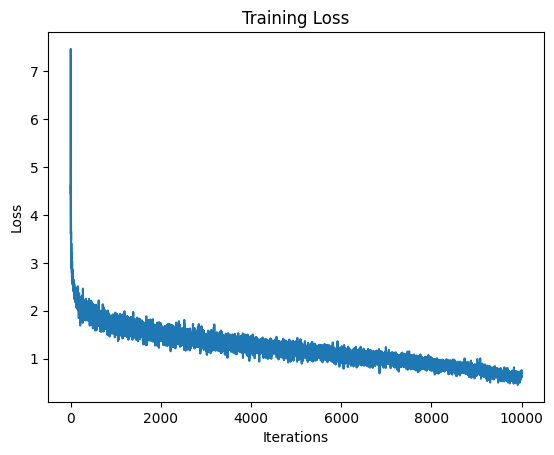

In [ ]:
### Define optimizer and training operation ###

# Instantiate the model
model = LSTMModel(vocab_size, params["embedding_dim"], params["hidden_size"])
model.to(device)

# Instantiate the optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=params["learning_rate"])

def train_step(x, y):
    model.train()
    optimizer.zero_grad()
    y_hat = model(x)
    loss = compute_loss(y, y_hat)
    loss.backward()
    optimizer.step()
    return loss

history = []

if hasattr(tqdm, '_instances'): tqdm._instances.clear()

for iter in tqdm(range(params["num_training_iterations"])):
    # Get a batch of training data
    x_batch, y_batch = get_batch(vectorized_songs, params["seq_length"], params["batch_size"])

    # Convert to tensors and move to device
    x_batch = torch.tensor(x_batch, dtype=torch.long).to(device)
    y_batch = torch.tensor(y_batch, dtype=torch.long).to(device)

    # Train step
    loss = train_step(x_batch, y_batch)

    # Logging
    history.append(loss.item())
    if iter % 1000 == 0:
        print(f"Iter {iter}: Loss = {loss.item():.4f}")

    # Save checkpoint
    if iter % 100 == 0:
        torch.save(model.state_dict(), checkpoint_prefix)

# Save final model
torch.save(model.state_dict(), checkpoint_prefix)

# Optional: Plot training loss
import matplotlib.pyplot as plt
plt.plot(history)
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.title("Training Loss")
plt.show()


In [ ]:
# Saving the model after training
torch.save(model.state_dict(), "/note-flow.pt")

In [ ]:
def generate_text(model, start_string, generation_length=1000, temperature=1.0):
    # Evaluation mode (disables dropout)
    model.eval()

    # Convert starting string to numbers
    input_eval = [char2idx[s] for s in start_string]
    input_eval = torch.tensor([input_eval], dtype=torch.long).to(device)

    # Initialize hidden state
    hidden = model.init_hidden(1, device)

    text_generated = []

    # Generate sequence
    with torch.no_grad():  # No gradient calculation needed
        for i in range(generation_length):
            # Get predictions
            predictions, hidden = model(input_eval, hidden, return_state=True)

            # Get last character's predictions
            predictions = predictions[:, -1, :] / temperature
            probabilities = torch.softmax(predictions, dim=-1)

            # Sample from the distribution
            predicted_id = torch.multinomial(probabilities, 1).item()

            # Append predicted character and prepare next input
            text_generated.append(idx2char[predicted_id])
            input_eval = torch.tensor([[predicted_id]], dtype=torch.long).to(device)

    # Combine the start string and generated text
    full_text = start_string + ''.join(text_generated)

    return full_text

# Generate music - Variation 1
start_string = "X:1\nT:Generated\nM:4/4\nL:1/8\nK:D\n"
generated_music = generate_text(model, start_string, generation_length=500, temperature=0.8)

play_song(generated_music)